# Explore data and visualize feature maps

## Necessary imports

In [13]:
import os
import sys
import json

import numpy as np

from git_root import git_root

sys.path.append(git_root("utils"))
from utils import read_in_data, generate_short_term_piece, quantize
from utils import load_params, load_config

import exploration as ex

import preprocessing_pipeline as pp

In [14]:
data_root = git_root("data", "sample_data")
train_root = os.path.join(data_root, "train")
test_root = os.path.join(data_root, "test")

In [15]:
params = load_params()
config = load_config()

In [16]:
seed = 4
R = np.random.RandomState(seed)

In [17]:
sampling_rate = params["sampling_rate"]
using_sample_data = config["using_sample_data"]

In [18]:
n_train = config["train_percent"] * config["sample_data_per_genre"] // 10
n_pieces = n_train * params["divide"]["number_pieces"]

## Load data

Loading and understanding the types of the loaded data:

In [19]:
data = read_in_data(sampling_rate, sample_data=using_sample_data)

In [24]:
max_l = 0
min_l = np.Inf
for d in data["train"]:
    max_l = max(max_l, d[1].shape[0])
    min_l = min(min_l, d[1].shape[0])
print(max_l)
print(min_l)

675808
661100


In [8]:
print(type(data))

<class 'dict'>


In [9]:
for key in data:
    print(key)

train
test


In [10]:
print(type(data["train"]))

<class 'list'>


In [11]:
# check that we have the expected number of tracks
ex.check_length(data, n_train)                                 

Actual length of the train data: 180
Expected length of the train data: 180


In [12]:
_ = ex.print_element(data, piece_wise=False, seed=seed)

Example:
        file_name: metal.00081.wav
        numpy_representation: [ 0.05136108  0.03598022  0.00067139 ... -0.15332031 -0.09997559
 -0.14892578]
        shape of the array: (661504,)
        
        genre: metal
        


## Check audio files

Let's listen to two random tracks of each genre for three random genres:

In [13]:
ex.display_random_audio(seed=seed)

Genres picked are: ['disco' 'reggae' 'hiphop'] 

Tracks for genre - disco
disco.00041.wav


disco.00049.wav


Tracks for genre - reggae
reggae.00043.wav


reggae.00094.wav


Tracks for genre - hiphop
hiphop.00024.wav


hiphop.00081.wav


To the human ear, the genres seem fairly easy to distinguish, the human baseline would probably be very high on this task. They seem to have included som `RnB` in `pop` (e.g. `pop.00056.wav`). Some `country` labeling is debatable (e.g. `country.00059.wav`). You might want to listen to these tracks below

In [14]:
noticeable_tracks = [
    "pop.00056.wav",
    "country.00059.wav"
]

In [15]:
ex.display_some_audio(noticeable_tracks, ask_user=False)

pop.00056.wav


country.00059.wav


## Cut the numpy arrays into short-term pieces

In [16]:
data_pieces = pp.generate_short_term_pieces_from_dict(data)

In [17]:
# check that we have the expected number of pieces
ex.check_length(data_pieces, n_pieces, asserting=False)

Actual length of the train data: 2517
Expected length of the train data: 2520


We lost three pieces along the way! Probably from tracks that were shorter than the others. Let's check:

In [18]:
piece_count = {}
for piece in data_pieces['train']:
    if not piece[0] in piece_count:
        piece_count[piece[0]] = 1
    else:
        piece_count[piece[0]] += 1

In [19]:
shorter_tracks = []
for track in piece_count:
    if piece_count[track] < 14:
        shorter_tracks.append(track)
print(shorter_tracks)

['classical.00051.wav', 'country.00007.wav', 'rock.00038.wav']


We got three distinct tracks - of three distinct genres - so each of them is missing one piece. Let's fetch the numpy representations in the undivided data to look at their respective length.

In [20]:
shorter_track_arrays = {track: None for track in shorter_tracks}
for track in data["train"]:
    if track[0] in shorter_tracks:
        shorter_track_arrays[track[0]] = track

In [21]:
for track in shorter_track_arrays:
    print(len(shorter_track_arrays[track][1]))

661344
661100
661408


Comparing with a couple random lengths of tracks in data:

In [22]:
min_length = np.Inf
for i in range(4):
    random_length = len(data["train"][R.randint(n_train)][1])
    min_length = min(min_length, random_length)
    print(random_length)
print(f"minlength: {min_length}")

661504
661794
661504
661794
minlength: 661504


The longest of the misfit tracks is still at least ~100 data points smaller than the minimum length of randomly sampled tracks

We will pad the arrays that are too small with zeros to reach the minimum size of the arrays that passed the divide. For this, we need to fetch the minimum length of all passing arrays:

In [23]:
min_length = np.Inf
argmin = None
for track in data["train"]:
    if not track[0] in shorter_tracks:
        length = len(track[1])
        if length < min_length:
            argmin = track
            min_length = length
print(min_length)

661504


In [24]:
for i, track in enumerate(data["train"]):
    if track[0] in shorter_tracks:
        pad_length = min_length - len(track[1])
        data["train"][i] = (
            track[0], np.pad(track[1], pad_length), track[2]
        )

Now let's re-compute pieces and check:

In [25]:
data_pieces = pp.generate_short_term_pieces_from_dict(data)

In [26]:
# check that we have the expected number of pieces
ex.check_length(data_pieces, n_pieces)

Actual length of the train data: 2520
Expected length of the train data: 2520


All good!

In [27]:
index = ex.print_element(data_pieces, seed=seed)

Example:
        file_name: hiphop.00055.wav
        numpy_representation: [0.04202271 0.28857422 0.31970215 ... 0.00064087 0.01043701 0.01330566]
        shape of the array: (88200,)
        piece_number: 12
        genre: hiphop
        


In [28]:
# print the element after that
_ = ex.print_element(data_pieces, i=index+1)

Example:
        file_name: hiphop.00055.wav
        numpy_representation: [ 0.01519775 -0.00820923 -0.00271606 ...  0.09466553  0.09326172
  0.09179688]
        shape of the array: (88200,)
        piece_number: 13
        genre: hiphop
        


Let's check that we haven't messed things up and are able to **re-construct coherent music pieces from some random short-term pieces**:

In [29]:
ex.display_random_audio_pieces(data_pieces, seed=seed)

Genres picked are: ['disco' 'reggae'] 

 -- Tracks for genre - disco -- 
 
Full track:
disco.00041.wav


840
Random short-term pieces of the track:
piece 10


piece 3


Full track:
disco.00049.wav


854
Random short-term pieces of the track:
piece 7


piece 4


 -- Tracks for genre - reggae -- 
 
Full track:
reggae.00043.wav


2100
Random short-term pieces of the track:
piece 13


piece 1


Full track:
reggae.00094.wav


2240
Random short-term pieces of the track:
piece 0


piece 11


These samples give new insights on the genre: `metal` and `rock` are harder to distinguish than expected - the both of us working on this project weren't sure how to label some pieces!
We got a piece from `disco` that is hard to pin down to solely `disco`; a curious hybrid of `rock` and `disco`. This might harder than expected!

**The good news is we're able to reconstruct the sound from the short-term pieces and they correspond to the right full tracks!**

## Generate spectrograms and visualize them

In [30]:
spectrograms = pp.generate_spectrograms_from_dict(data_pieces)

In [31]:
# check that we have the expected number of maps
ex.check_length(spectrograms, n_pieces)

Actual length of the train data: 2520
Expected length of the train data: 2520


In [32]:
index = ex.print_element(spectrograms, seed=seed)

Example:
        file_name: hiphop.00055.wav
        numpy_representation: [[-30.41579  -51.388523 -51.575584 ... -80.       -53.143635 -50.14027 ]
 [-31.150936 -52.07938  -53.51206  ... -53.35323  -53.00819  -51.80172 ]
 [-31.606892 -60.56081  -59.365448 ... -69.07425  -58.341595 -63.123383]
 ...
 [-58.504944 -69.68489  -80.       ... -80.       -80.       -80.      ]
 [-52.494747 -69.63728  -79.41519  ... -80.       -80.       -80.      ]
 [-47.35408  -62.716324 -80.       ... -80.       -80.       -80.      ]]
        shape of the array: (2051, 44)
        piece_number: 12
        genre: hiphop
        


Let's visualize a random spectrogram for a piece of a track:

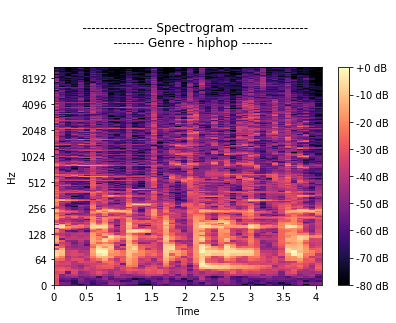

In [33]:
ex.plot_one_map(
    spectrograms['train'][index], "spectrogram"
)

**Let's now do so for all genres, with 5 randomly sampled pieces per genre**:

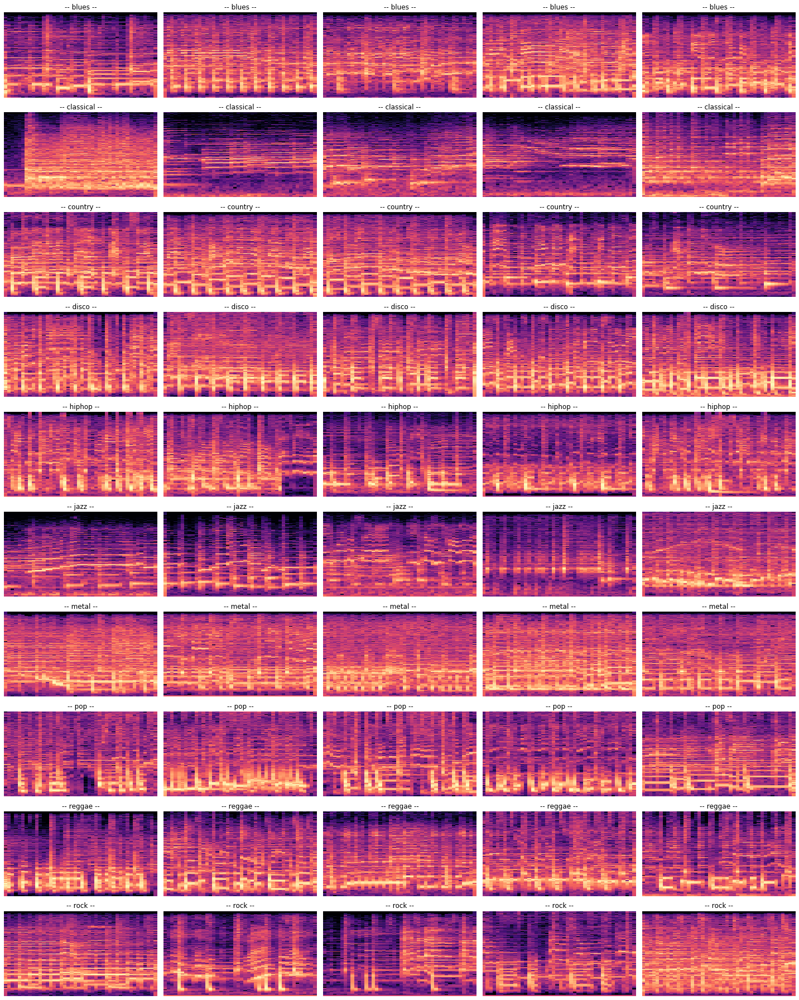

In [34]:
ex.plot_random_maps(
    spectrograms, n_per_genre=5, map_type="spectrogram", seed=seed
)

Now classifiying these images into genres for the human eye is a completely hopeless task (although domain knowledge might significantly improve the human-baseline accuracy, it's probably still going to be very far from an audio-based classification for the human ear).

A couple noticeable aspects of the spectrogram:

- `metal` is saturated in many frequencies (high dB)
- `jazz`, `blues` and `classical` seems mostly devoid of the higher frequencies
- the `hiphop` baseline (low frequencies) stands out against the rest of the spectrum
- the `disco` low frequency beats are somewhat more apparent than other genres, at regularly-spaced intervals
- time variations for `classical` music are more seamless than other genres

The genres evoked might be easier to classify than their counterparts, that show little stand-out features so far.

## Generate the mel-maps and visualize them

In [35]:
mel_maps = pp.generate_mel_maps_from_dict(data_pieces)

In [36]:
# check that we have the expected number of maps
ex.check_length(mel_maps, n_pieces)

Actual length of the train data: 2520
Expected length of the train data: 2520


In [37]:
index = ex.print_element(mel_maps, seed=seed)

Example:
        file_name: hiphop.00055.wav
        numpy_representation: [[ -8.266455 -16.697027 -28.432217 ...  -7.872059 -21.035202 -22.329502]
 [ -8.220915 -10.495068 -23.74516  ... -10.608154 -22.060322 -21.121307]
 [-10.322472 -23.08001  -27.75213  ... -10.479027 -14.118496 -16.140266]
 ...
 [-47.142212 -63.069542 -62.706062 ... -54.76213  -67.017235 -69.84484 ]
 [-47.196552 -64.01269  -66.0087   ... -62.750793 -71.32644  -73.70938 ]
 [-47.50505  -67.29722  -68.916405 ... -66.172226 -70.05536  -74.23206 ]]
        shape of the array: (40, 33)
        piece_number: 12
        genre: hiphop
        


**Now, time to visualize some mel maps: let's do so for all genres, with 5 randomly sampled pieces per genre - but first for the random mel map fetched above.**

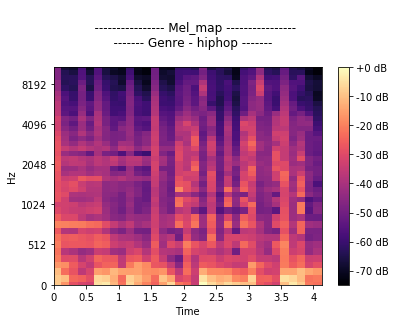

In [38]:
ex.plot_one_map(
    mel_maps['train'][index], "mel_map"
)

First we notice that the image is much more "pixelized" than the spectrograms. This is is because we only used 40 channels to compute the mel scale - as was suggested in the paper - whereas the spectrogram has 2051 bins frequency wise!

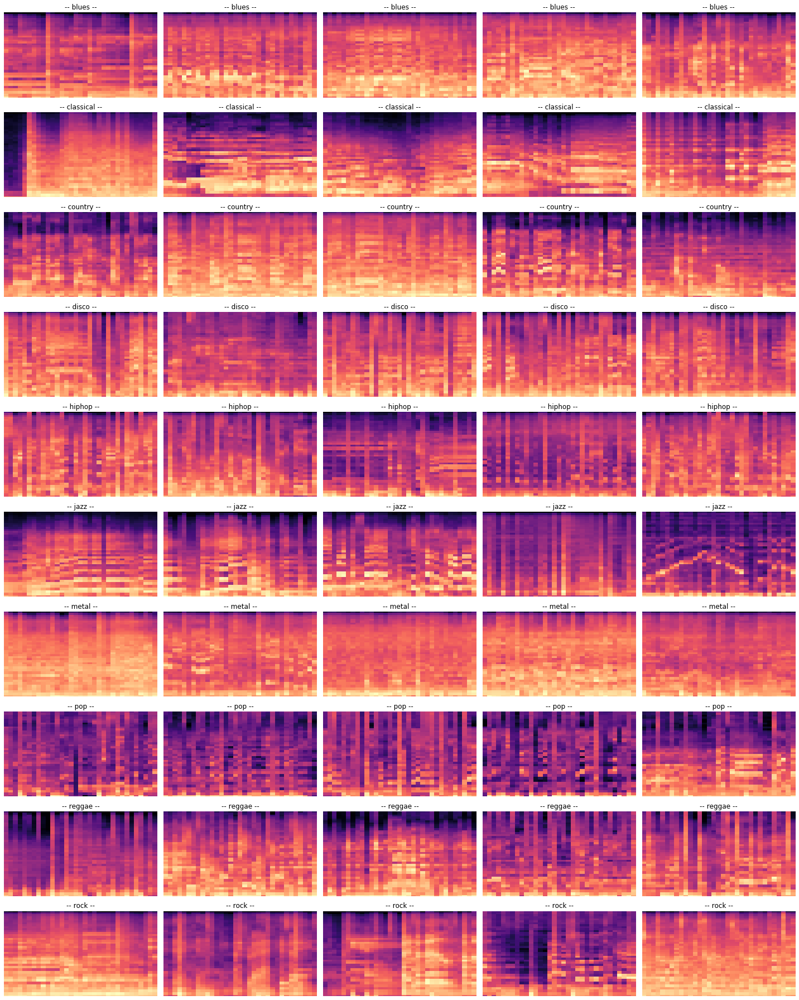

In [39]:
# setting the same seed as the `spectrograms` plot guarantees that we plot
# the same tracks - for a nice and easy comparison
ex.plot_random_maps(
    mel_maps, n_per_genre=5, map_type="mel_map", seed=seed
)

If anything, those maps seem harder to classify than the spectrograms, because of the coarse granularity of the map due to the low number of channels. 

The `pop` maps stand out from lack of intensity across a large majority of the bins

## Quantizing the maps

To understand how we should quantize the maps let's see the range of values (dB) they can take:

In [40]:
_, _ = ex.display_unique_extremes(mel_maps, "mel_map")

Unique mins of mel_map are:
[-80.       -79.991234 -79.98711  ... -42.13545  -41.013493 -40.196243] 

Unique maxs of mel_map are:
[-3.8146973e-06 -1.9073486e-06 -9.5367432e-07 -4.7683716e-07
  0.0000000e+00  5.9604645e-08  1.1920929e-07  4.7683716e-07
  9.5367432e-07  1.9073486e-06  3.8146973e-06]
    


In [41]:
_, _ = ex.display_unique_extremes(spectrograms, "spectrograms")

Unique mins of spectrograms are:
[-80.] 

Unique maxs of spectrograms are:
[-3.8146973e-06 -1.9073486e-06 -9.5367432e-07  0.0000000e+00
  1.9073486e-06  3.8146973e-06]
    


The paper mentions quantizing into 16 buckets: all values fit grossly within `[-80dB, 0dB]` so we will quantize in buckets of `5 dB` for all maps! (the last bucket will also contain values slightly higher than 0)

In [42]:
quantized_spectrograms = pp.generate_quantized_maps_from_dict(spectrograms)

In [43]:
# check that we have the expected number of maps
ex.check_length(quantized_spectrograms, n_pieces)

Actual length of the train data: 2520
Expected length of the train data: 2520


In [44]:
index = ex.print_element(quantized_spectrograms, seed=seed)

Example:
        file_name: hiphop.00055.wav
        numpy_representation: [[10  6  6 ...  1  6  6]
 [10  6  6 ...  6  6  6]
 [10  4  5 ...  3  5  4]
 ...
 [ 5  3  1 ...  1  1  1]
 [ 6  3  1 ...  1  1  1]
 [ 7  4  1 ...  1  1  1]]
        shape of the array: (2051, 44)
        piece_number: 12
        genre: hiphop
        


In [45]:
_, _ = ex.display_unique_extremes(quantized_spectrograms, "quantized spectrogram")

Unique mins of quantized spectrogram are:
[1] 

Unique maxs of quantized spectrogram are:
[16]
    


In [46]:
quantized_mel_maps = pp.generate_quantized_maps_from_dict(mel_maps)

In [47]:
# check that we have the expected number of maps
ex.check_length(quantized_mel_maps, n_pieces)

Actual length of the train data: 2520
Expected length of the train data: 2520


In [48]:
index = ex.print_element(quantized_mel_maps, seed=seed)

Example:
        file_name: hiphop.00055.wav
        numpy_representation: [[15 13 11 ... 15 12 12]
 [15 14 12 ... 14 12 12]
 [14 12 11 ... 14 14 13]
 ...
 [ 7  4  4 ...  6  3  3]
 [ 7  4  3 ...  4  2  2]
 [ 7  3  3 ...  3  2  2]]
        shape of the array: (40, 33)
        piece_number: 12
        genre: hiphop
        


In [49]:
_, _  = ex.display_unique_extremes(quantized_mel_maps, "quantized mel_map")

Unique mins of quantized mel_map are:
[1 2 3 4 5 6 7 8] 

Unique maxs of quantized mel_map are:
[16]
    


The minimums of the mel maps are much more spread out across different tracks as we saw before quantization: if this aligns roughly with the genres this might have a high predictive impact on the classification. Let's dive into this a bit more. Let's visualize how the counts of different minima vary across genres:

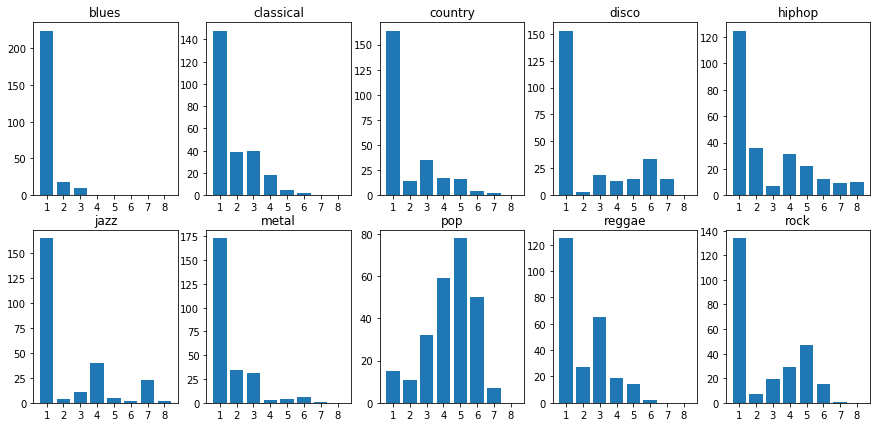

In [50]:
ex.display_genre_min_counts(quantized_mel_maps)

The minima seem to leak a significant amount of information:

- `pop` has the least amount of minima in the lowest bucket, on the contrary its mode is at the fifth bucket!
- all the other genres have their mode in the first bucket, by a significant amount
- `blues` solely has any minimums outside of the first bucket

The first bucket corresponds to a lot of silence and very low ambient sounds: the paper proposes to get rid of it after building the co-occurence maps, and we will do so! This will prevent leakage, especially regarding the `pop` genre

(A baseline that only uses the minima of the track pieces could be an interesting one to try out!)